# Milestone 1

Spotify Meta Data

This milestone covers the EDA and basic data cleaning.

## Note:
1. Certain cells appear redundant but have been included as they might be referenced in a later part of the notebook.
2. Comments will be added in the form of markdown cells as well and code comments starting with '#'. They are present to help clarify certain choices
3. Requirements are provided in requirements.txt

In [1]:
import pandas as pd
import numpy as np

In [2]:
import matplotlib.pyplot as plt

In [3]:
from tqdm import tqdm

In [4]:
import seaborn as sns

In [5]:
import plotly.express as px

from sklearn.decomposition import PCA

import plotly.graph_objects as go

import math

In [6]:
# running this cell allows us to use progress_apply instead of an ordinary DataFrame.apply.
# This allows us to track progress instead of leaving us to wonder if the notebook has crashed or not
tqdm.pandas()

In [7]:
#d_a  = pd.read_csv('data_by_artist.csv')
#d_g  = pd.read_csv('data_by_genres.csv')
#d_y  = pd.read_csv('data_by_year.csv')
d_wg = pd.read_csv('data/data_w_genres.csv')
data = pd.read_csv('data/data.csv')

In [8]:
sns.set_theme()

## 1. Data Cleaning

### Remove duplicates with same values for all columns and keep the first occurrence

In [9]:
data = data.drop_duplicates(keep='first')
print(data.shape)

(172230, 19)


### Remove duplicates with same values for all columns except 'id' and keep the first occurrence

In [10]:
data = data.drop_duplicates(subset=['acousticness', 'artists', 'danceability', 'duration_ms', 'energy', 'explicit', 'instrumentalness', 'key', 'liveness', 'loudness', 'mode', 'name', 'popularity', 'release_date', 'speechiness', 'tempo', 'valence', 'year'], keep="first")
print(data.shape)

(171226, 19)


### Sort by 'release_date', then remove duplicates with same values for 'artists' and 'name' and keep the first occurrence

In [11]:
data = data.sort_values(['release_date']).drop_duplicates(subset=['artists', 'name'], keep="first")
print(data.shape)

(159441, 19)


## 2. Data with genre

This section converts the str form of the lists to accessible list form using the built-in eval()

In [12]:
print(d_wg.shape)
d_wg.head().artists[0]

(32539, 16)


'"Cats" 1981 Original London Cast'

In [13]:
# could also just pass eval
eval_func = lambda x : eval(x)

In [14]:
d_wg['genres'] = d_wg.genres.progress_apply(eval)

100%|█████████████████████████████████████████████████████████████████████████| 32539/32539 [00:00<00:00, 94115.35it/s]


Checking the count of empty genre lists

In [15]:
# Just checking the counts of empty genre column since they are stored as empty lists
print(d_wg['genres'].apply(lambda x: len(x) == 0).sum())
d_wg['genres'].apply(lambda x: len(x) == 0 and isinstance(x, list)).sum()

13563


13563

## 3. General data - song level EDA

### 3.1 heatmap

In [16]:
data['artists'] = data.artists.apply(eval)

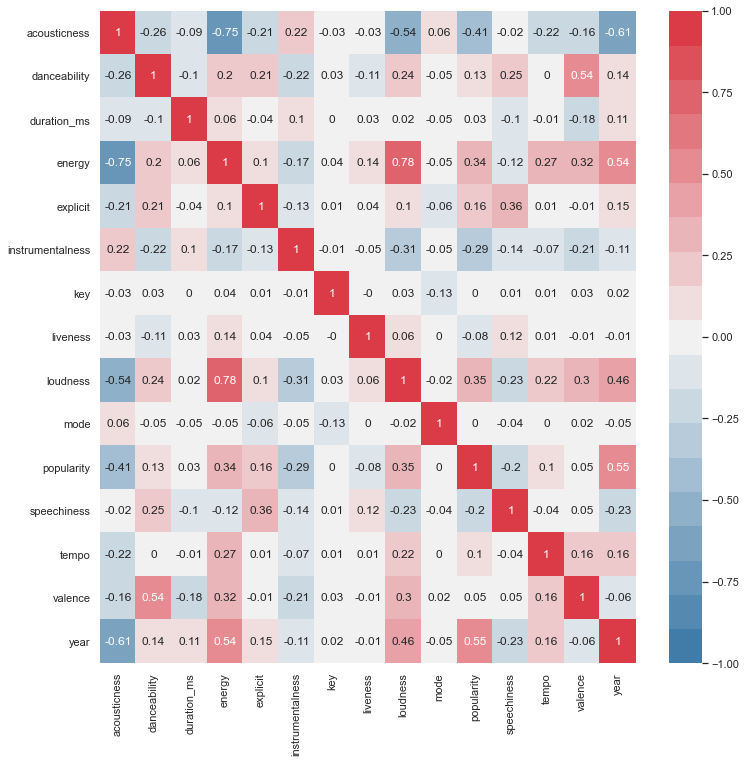

In [17]:
plt.figure(figsize=(12,12))
sns.heatmap(data.corr().round(2), vmin=-1, vmax=1,
            cmap = sns.diverging_palette(240, 10, n=data.columns.size),
            annot = True);

In [18]:
data['decade'] = (data['year'] // 10) *10

### 3.1 Distribution of songs by decade

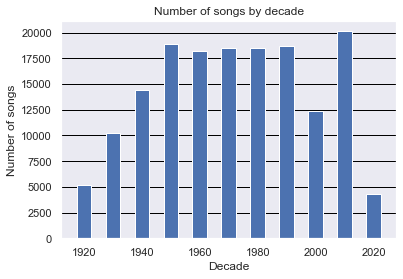

In [19]:
decade_count_df = data.groupby(data['decade']).size()

sz = np.array(decade_count_df.index.values)
ht = decade_count_df.to_numpy()

plt.bar(sz, ht, width=5)
plt.title("Number of songs by decade")
plt.xlabel("Decade")
plt.ylabel("Number of songs")
plt.grid(b=True, axis='y', color='black')
plt.grid(b=False, axis='x')




plt.show()

### 3.2 Trend of selected features by decade

In [20]:
acousticness_decade_df = data[['decade', 'acousticness']]
acousticness_decade_df = acousticness_decade_df.groupby(['decade']).mean()
acousticness_decade_df.reset_index(drop=True)

energy_decade_df = data[['decade', 'energy']]
energy_decade_df = energy_decade_df.groupby(['decade']).mean()

loudness_decade_df = data[['decade', 'loudness']]
loudness_decade_df = loudness_decade_df.groupby(['decade']).mean()

tempo_decade_df = data[['decade', 'tempo']]
tempo_decade_df = tempo_decade_df.groupby(['decade']).mean()

print(acousticness_decade_df)

        acousticness
decade              
1920        0.778190
1930        0.812454
1940        0.868264
1950        0.837177
1960        0.630502
1970        0.405500
1980        0.308809
1990        0.317008
2000        0.271336
2010        0.231360
2020        0.232980


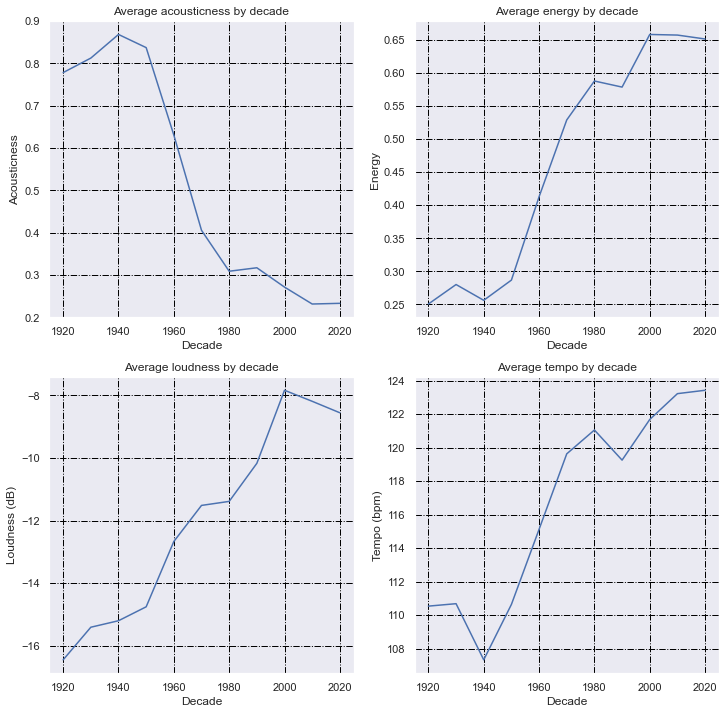

In [21]:
fig, ax = plt.subplots(2, 2, figsize=(12, 12))


ax[0][0].plot(acousticness_decade_df['acousticness'], label='Acousticness')
ax[0][0].set_xlabel('Decade')
ax[0][0].set_ylabel('Acousticness')
ax[0][0].set_title("Average acousticness by decade")
ax[0][0].grid(b=True, linestyle='-.', color='black')

ax[0][1].plot(energy_decade_df['energy'], label='Energy')
ax[0][1].set_xlabel('Decade')
ax[0][1].set_ylabel('Energy')
ax[0][1].set_title("Average energy by decade")
ax[0][1].grid(b=True, linestyle='-.', color='black')


ax[1][0].plot(loudness_decade_df['loudness'])
ax[1][0].set_xlabel('Decade')
ax[1][0].set_ylabel('Loudness (dB)')
ax[1][0].set_title("Average loudness by decade")
ax[1][0].grid(b=True, linestyle='-.', color='black')


ax[1][1].plot(tempo_decade_df['tempo'])
ax[1][1].set_xlabel('Decade')
ax[1][1].set_ylabel('Tempo (bpm)')
ax[1][1].set_title("Average tempo by decade")
ax[1][1].grid(b=True, linestyle='-.', color='black')

### 3.3 Diving into acousticness, energy and loudness

In [22]:
decade_data = data.drop('year', axis=1)

<AxesSubplot:xlabel='valence', ylabel='Density'>

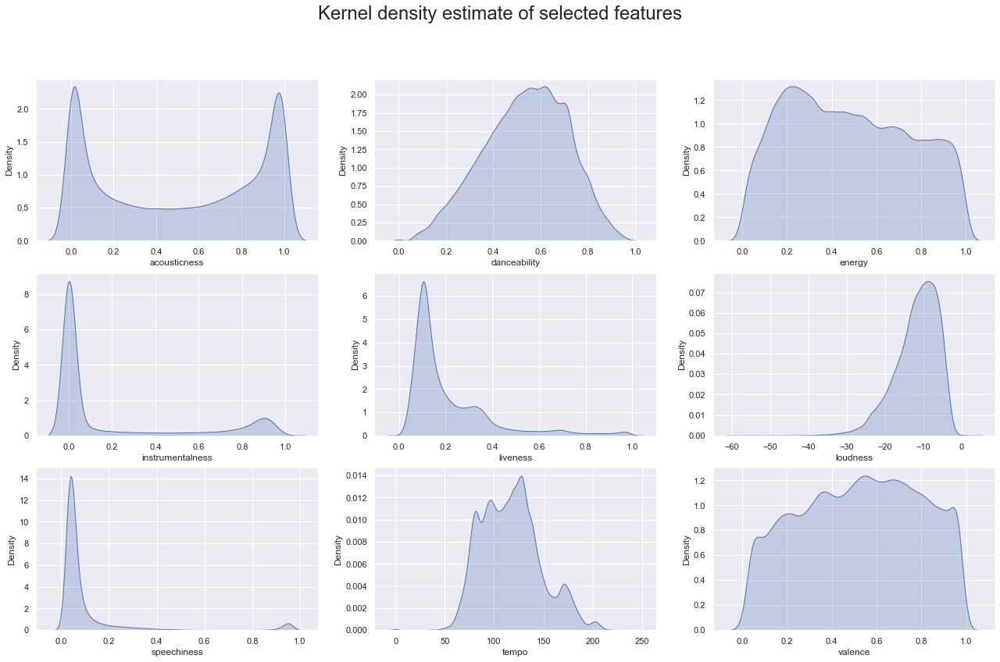

In [23]:
fig, ax = plt.subplots(3, 3, figsize=(22, 13))

fig.suptitle("Kernel density estimate of selected features", fontsize=24)
sns.kdeplot(ax=ax[0, 0], data=decade_data['acousticness'], shade=True)
sns.kdeplot(ax=ax[0, 1], data=decade_data['danceability'], shade=True)
sns.kdeplot(ax=ax[0, 2], data=decade_data['energy'], shade=True)
sns.kdeplot(ax=ax[1, 0], data=decade_data['instrumentalness'], shade=True)
sns.kdeplot(ax=ax[1, 1], data=decade_data['liveness'], shade=True)
sns.kdeplot(ax=ax[1, 2], data=decade_data['loudness'], shade=True)
sns.kdeplot(ax=ax[2, 0], data=decade_data['speechiness'], shade=True)
sns.kdeplot(ax=ax[2, 1], data=decade_data['tempo'], shade=True)
sns.kdeplot(ax=ax[2, 2], data=decade_data['valence'], shade=True)

<AxesSubplot:xlabel='acousticness', ylabel='loudness'>

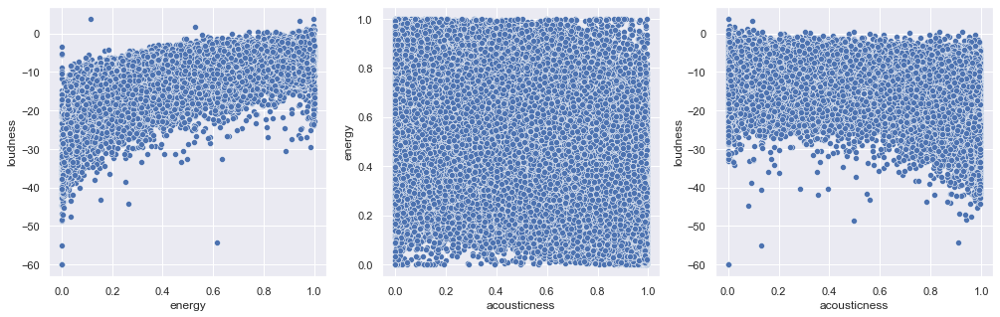

In [24]:
fig, ax = plt.subplots(1, 3, figsize=(17, 5))

sns.scatterplot(ax=ax[0], data=decade_data, x="energy", y="loudness")
sns.scatterplot(ax=ax[1], data=decade_data, x="acousticness", y="energy")
sns.scatterplot(ax=ax[2], data=decade_data, x="acousticness", y="loudness")

## 4. Cleaning and merging - (Optional for Genre analysis)

In [25]:
len(set(d_wg.loc[d_wg.genres.apply(bool)].artists.tolist()))

18976

In [26]:
useful_artists = d_wg.loc[d_wg.genres.progress_apply(lambda x: bool(x))].artists.tolist()
len(useful_artists)

100%|████████████████████████████████████████████████████████████████████████| 32539/32539 [00:00<00:00, 862957.52it/s]


18976

In [27]:
%%time
# test = data.iloc[:]
useful_data = data.loc[data.artists.progress_apply(lambda x: bool(set(list(x)).intersection(set(useful_artists))))]
# other_data  = data.loc[data.artists.progress_apply(lambda x:  not bool(set(x).intersection(set(useful_artists))))]
other_data  = data.loc[[True if i not in useful_data.index else False for i in range(data.shape[0])]]

100%|████████████████████████████████████████████████████████████████████████| 159441/159441 [01:39<00:00, 1597.55it/s]


Wall time: 1min 39s


In [28]:
sum([True if i not in useful_data.index else False for i in range(data.shape[0])])

35286

In [29]:
useful_data = useful_data.reset_index(drop=True)
other_data  = other_data.reset_index(drop=True)

In [30]:
useful_data.shape[0], other_data.shape

(136073, (35286, 20))

In [31]:
import itertools

In [32]:
major_genre_set = set()

def get_genres(artists):
    global major_genre_set
    
    genre_set = set()
    temp = d_wg.loc[d_wg.artists.apply(lambda x: bool(set([x]).intersection(set(artists)))), 'genres'].tolist()
    temp  = list(itertools.chain(*temp))
#     print(temp)
    genre_set.update(temp)
    major_genre_set.update(temp)
    
    return list(genre_set)

check_list = ['"Cats" 1981 Original London Cast',]

The cell below is used to store the processed data. It is not used in the modelling since we abandonned the recommender system efforts.

In [33]:
# %%time
# useful_data['genres'] = useful_data.artists.progress_apply(get_genres)

# useful_data.to_csv('useful_data1.csv', index=False)

# print(useful_data.shape)

# other_data.to_csv('other_data.csv', index=False)

# print(other_data.shape)

### 4.b Outlier analysis - Genre data

Data with genres gives artist data with associated genre information. It allows the subsequent analysis

In [34]:
data_gnr = pd.read_csv('data/data_w_genres.csv')

In [35]:
# data['artists'] = data.artists.apply(lambda x: eval(x))
data_gnr['genres'] = data_gnr.genres.apply(lambda x: eval(x))

In [36]:
from collections import Counter

In [37]:
test_ctr = Counter()

In [38]:
Counter([1,2,3,1,1,1,1,1])

Counter({1: 6, 2: 1, 3: 1})

In [39]:
set_genres = set()
genre_counter = Counter()
def collect_genres(x):
    global genre_counter, set_genres
#     print(x.genres)
    if x.genres:
        genre_counter += Counter(x.genres)
        set_genres.update(x.genres)
    
data_gnr.apply(collect_genres, axis=1);

In [40]:
genre_counter

Counter({'show tunes': 172,
         'comedy rock': 2,
         'comic': 77,
         'parody': 7,
         'florida rap': 12,
         'underground hip hop': 153,
         'vapor trap': 78,
         'dark trap': 45,
         'meme rap': 37,
         'new orleans rap': 18,
         'broadway': 111,
         'hollywood': 152,
         'boston rock': 26,
         'dance rock': 274,
         'new romantic': 176,
         'new wave': 212,
         'new wave pop': 312,
         'synthpop': 144,
         'experimental hip hop': 8,
         'indie soul': 92,
         'detroit hip hop': 17,
         'hip hop': 487,
         'rap': 498,
         'k-pop': 47,
         'k-pop girl group': 15,
         'alternative metal': 269,
         'industrial metal': 70,
         'nu metal': 195,
         'rap metal': 43,
         'rap rock': 122,
         'boy band': 52,
         'dance pop': 576,
         'europop': 140,
         'pop': 582,
         'indy indie': 4,
         'alternative rock': 302,
     

In [41]:
X = sorted(genre_counter.items(), key=lambda x: x[1], reverse=True)

In [42]:
# useful_data.to_csv('useful_data1.csv', index=False)

In [43]:
print(useful_data.shape)

(136073, 20)


In [44]:
# other_data.to_csv('other_data.csv', index=False)

In [45]:
print(other_data.shape)

(35286, 20)


In [46]:
X

[('rock', 601),
 ('pop', 582),
 ('dance pop', 576),
 ('rap', 498),
 ('hip hop', 487),
 ('pop rap', 463),
 ('country rock', 429),
 ('urban contemporary', 374),
 ('pop rock', 373),
 ('mellow gold', 368),
 ('soft rock', 368),
 ('adult standards', 360),
 ('latin', 353),
 ('trap', 346),
 ('classic rock', 337),
 ('album rock', 332),
 ('pop dance', 332),
 ('modern rock', 329),
 ('funk', 323),
 ('folk rock', 321),
 ('new wave pop', 312),
 ('alternative rock', 302),
 ('southern hip hop', 301),
 ('gangster rap', 299),
 ('country', 292),
 ('quiet storm', 290),
 ('r&b', 285),
 ('indie pop', 285),
 ('soul', 285),
 ('brill building pop', 281),
 ('tropical', 279),
 ('classical performance', 279),
 ('hard rock', 277),
 ('art rock', 276),
 ('dance rock', 274),
 ('post-teen pop', 274),
 ('folk', 272),
 ('alternative metal', 269),
 ('edm', 268),
 ('indie rock', 265),
 ('electropop', 254),
 ('roots rock', 252),
 ('progressive house', 244),
 ('regional mexican', 239),
 ('blues rock', 232),
 ('motown', 231)

In [47]:
len(X)

3231

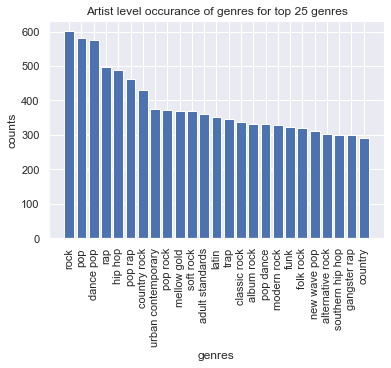

In [48]:
plt.Figure(figsize=(16,12))
plt.bar([x[0] for x in X[:25]], [x[1] for x in X[:25]])
plt.xticks(rotation=90)
plt.title('Artist level occurance of genres for top 25 genres')
plt.ylabel('counts')
plt.xlabel('genres')
plt.show()

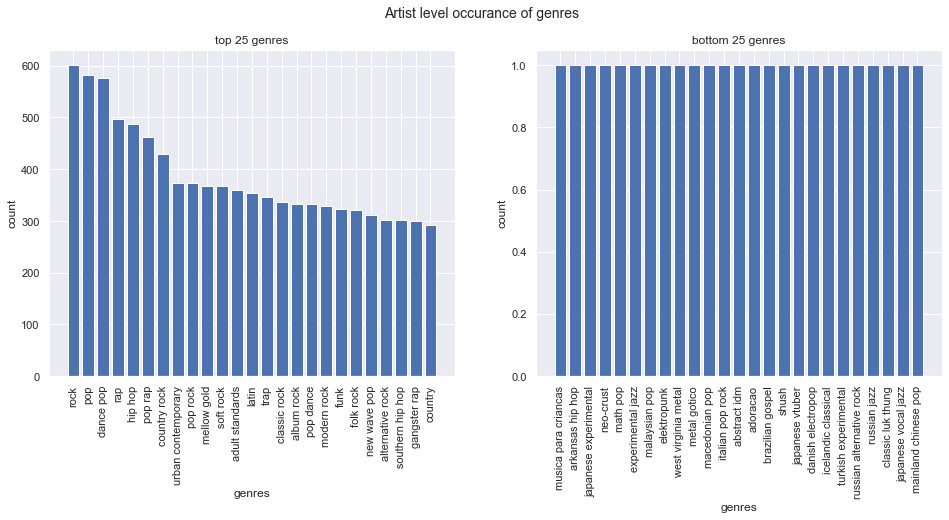

In [49]:
fig, ax = plt.subplots(1, 2, figsize=(16,6))

ax[0].bar([x[0] for x in X[:25]], [x[1] for x in X[:25]])
ax[0].set_title('top 25 genres')
ax[0].tick_params(axis="x", rotation=90)
ax[0].set_xlabel('genres')
ax[0].set_ylabel('count')

ax[1].bar([x[0] for x in X[-25:]], [x[1] for x in X[-25:]])
ax[1].set_title('bottom 25 genres')
ax[1].tick_params(axis="x", rotation=90)
ax[1].set_xlabel('genres')
ax[1].set_ylabel('count')

# plt.xticks(rotation=90)
plt.suptitle('Artist level occurance of genres', fontsize=14);
# plt.ylabel('counts')
# plt.xlabel('genres')
# plt.show()

In [50]:
set_genres

{'hungarian classical piano',
 'classical guitar',
 'british post-rock',
 'one-person band',
 'funk rock',
 'bush ballad',
 'christian uplift',
 'irish singer-songwriter',
 'south african rock',
 'australian house',
 'belgian metal',
 'visual kei',
 'country gospel',
 'norwegian singer-songwriter',
 'gqom',
 'mariachi cristiano',
 'classic colombian pop',
 'ska punk',
 'italian ska',
 'arkansas hip hop',
 'rebetiko',
 'american primitive',
 'eastern bloc groove',
 'norwegian metal',
 'escape room',
 'funk metal',
 'underground hip hop',
 'dark psytrance',
 'swedish classical',
 'scam rap',
 'son cubano clasico',
 'beats',
 'israeli pop',
 'dub reggae',
 'instrumental grime',
 'sound team',
 'ska mexicano',
 'german power metal',
 'new orleans blues',
 'rock uruguayo',
 'vegan straight edge',
 'australian americana',
 'pinoy indie',
 'chinese traditional',
 'dubstep product',
 'bluegrass gospel',
 'dutch moombahton',
 'spiritual hip hop',
 'guzheng',
 "children's story",
 'greek house',

In [51]:
data.sort_values('popularity', ascending=False).reset_index().iloc[:20]

,index,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,...,loudness,mode,name,popularity,release_date,speechiness,tempo,valence,year,decade
0,20062,0.7210,[Olivia Rodrigo],0.585,242014,0.436,1,7lPN2DXiMsVn7XUKtOW1CS,0.000013,10,...,-8.761,1,drivers license,100,2021-01-08,0.0601,143.874,0.1320,2021,2020
1,19862,0.2210,"[24kGoldn, iann dior]",0.700,140526,0.722,1,3tjFYV6RSFtuktYl3ZtYcq,0.000000,7,...,-3.558,0,Mood (feat. iann dior),96,2020-07-24,0.0369,90.989,0.7560,2020,2020
2,19866,0.4680,[Ariana Grande],0.737,172325,0.802,1,35mvY5S1H3J2QZyna3TFe0,0.000000,0,...,-4.771,1,positions,96,2020-10-30,0.0878,144.015,0.6820,2020,2020
3,19886,0.4010,"[Bad Bunny, Jhay Cortez]",0.731,205090,0.573,1,47EiUVwUp4C9fGccaPuUCS,0.000052,4,...,-10.059,0,DÁKITI,95,2020-10-30,0.0544,109.928,0.1450,2020,2020
4,19976,0.2120,[KAROL G],0.863,178947,0.666,1,7vrJn5hDSXRmdXoR30KgF1,0.000493,1,...,-4.158,0,BICHOTA,95,2020-10-23,0.1520,163.908,0.8380,2020,2020
5,19872,0.2130,[The Kid LAROI],0.662,161385,0.413,1,27OeeYzk6klgBh83TSvGMA,0.000000,0,...,-7.357,1,WITHOUT YOU,94,2020-11-06,0.0299,93.005,0.4670,2020,2020
6,19870,0.1900,[CJ],0.711,123429,0.598,1,5vGLcdRuSbUhD8ScwsGSdA,0.000000,3,...,-7.621,0,Whoopty,94,2020-08-20,0.1820,140.175,0.7370,2020,2020
7,19876,0.2180,[Billie Eilish],0.889,174321,0.340,0,54bFM56PmE4YLRnqpW6Tha,0.130000,11,...,-7.773,0,Therefore I Am,94,2020-11-12,0.0697,94.009,0.7160,2020,2020
8,19868,0.2370,[Ariana Grande],0.830,173711,0.585,1,6Im9k8u9iIzKMrmV7BWtlF,0.000000,0,...,-6.476,1,34+35,94,2020-10-30,0.0940,109.978,0.4850,2020,2020
9,19928,0.0303,"[Bad Bunny, ROSALÍA]",0.856,203201,0.618,0,2XIc1pqjXV3Cr2BQUGNBck,0.000000,7,...,-4.892,1,LA NOCHE DE ANOCHE,94,2020-11-27,0.2860,81.993,0.3910,2020,2020


## 5. Exploring song-level occurance of Artists

In [52]:
data_gnr.loc[data_gnr.artists.str.contains('Linkin')].sort_values('popularity', ascending=False).reset_index(False).iloc[:20]

,index,artists,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key,mode,count,genres
0,16795,Linkin Park,0.074934,0.558291,207411.769697,0.850436,0.030174,0.253508,-5.0996,0.093305,118.544406,0.474748,56.684848,9,1,165,"[alternative metal, nu metal, post-grunge, rap..."


In [53]:
def get_artist(df,name:str):
    f = lambda x: bool(set(x).intersection(set([name])))
    return df.loc[df.artists.apply(f)]    
    

In [54]:
set_artists = set()
artist_counter = Counter()
def collect_artist(x):
    global artist_counter, set_artists
#     print(x.genres)
    if x.artists:
        artist_counter += Counter(x.artists)
        set_artists.update(x.artists)
    
data.apply(collect_artist, axis=1);

In [55]:
artist_X = sorted(artist_counter.items(), key=lambda x: x[1], reverse=True)

In [56]:
X = artist_X

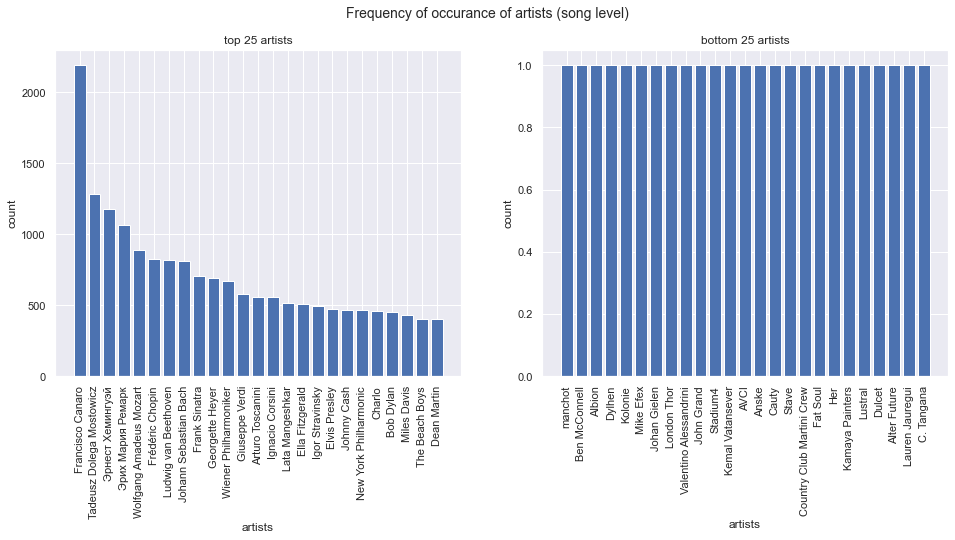

In [57]:
fig, ax = plt.subplots(1, 2, figsize=(16,6))

ax[0].bar([x[0] for x in X[:25]], [x[1] for x in X[:25]])
ax[0].set_title('top 25 artists')
ax[0].tick_params(axis="x", rotation=90)
ax[0].set_xlabel('artists')
ax[0].set_ylabel('count')

ax[1].bar([x[0] for x in X[-25:]], [x[1] for x in X[-25:]])
ax[1].set_title('bottom 25 artists')
ax[1].tick_params(axis="x", rotation=90)
ax[1].set_xlabel('artists')
ax[1].set_ylabel('count')

# plt.xticks(rotation=90)
plt.suptitle('Frequency of occurance of artists (song level)', fontsize=14);
# plt.ylabel('counts')
# plt.xlabel('genres')
# plt.show()

### 5.b Looking at proportion of artist's songs in a given year

#### Note: 
This section was initially run with useful_data1.csv, and now has been rerun with complete data since genre data is no longer important.

In [58]:
df_data_main = pd.read_csv('data/cleaned_data_wo_genres.csv')
df_data = df_data_main.copy()
df_data

,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo,valence,year
0,0.991,['Mamie Smith'],0.598,168333,0.22400,0,0cS0A1fUEUd1EW3FcF8AEI,0.000522,5,0.3790,-12.628,0,Keep A Song In Your Soul,12,1920,0.0936,149.976,0.6340,1920
1,0.986,['Dick Haymes'],0.208,182227,0.23400,0,5DihlLenQJhJXGJhbtiTrM,0.656000,8,0.2340,-15.427,1,Till the End of Time,0,1920,0.0426,85.288,0.2090,1920
2,0.994,['Dick Haymes'],0.392,165253,0.12800,0,5EwQxd2XGjp1BUZT2iHhEj,0.153000,2,0.0983,-15.220,1,You'll Never Know,0,1920,0.0378,126.728,0.2260,1920
3,0.992,['Dick Haymes'],0.344,171160,0.19600,0,5LnfrTxUQwINaVUIqaNmXa,0.004410,0,0.1570,-13.969,1,A Chapter in My Life Called Mary,0,1920,0.0365,79.837,0.3540,1920
4,0.891,"['ST', '98', 'R2S', 'Niklas O']",0.410,181969,0.29600,1,5RgQ7t5uimI5St2H3CV9pb,0.000005,0,0.0910,-13.879,0,Moyenne d'âge,0,1920,0.0386,127.946,0.0625,1920
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
159436,0.983,"['Mysterious World Music', 'Relaxing Zen Music...",0.775,212198,0.02330,0,7fro6vyclNNvph6Hp3AYMt,0.787000,6,0.0656,-17.366,1,Colorful Lights,0,2021-01-23,0.0430,80.021,0.5680,2021
159437,0.987,"['Mysterious World Music', 'Relaxing Zen Music...",0.807,182852,0.03690,0,1RquzdH44f8SFNTX4Uw6Z1,0.834000,7,0.2200,-13.781,1,Prosperity,0,2021-01-23,0.0824,80.076,0.2170,2021
159438,0.845,"['Mysterious World Music', 'Relaxing Zen Music...",0.210,148814,0.00405,0,6mpvRPFvsWWn326jiYhVJw,0.924000,1,0.1130,-26.079,1,Guardian of the Sea,0,2021-01-23,0.0438,76.501,0.0337,2021
159439,0.993,"['Mysterious World Music', 'Relaxing Zen Music...",0.649,194585,0.01870,0,1h7ZM2aWhaUBos7P0Fs0OJ,0.917000,3,0.0814,-21.098,0,Beauty of the Lotus,0,2021-01-23,0.0621,80.015,0.6620,2021


In [59]:
df_data = df_data.loc[: , ['artists' , 'year']]
df_data["artists"] = df_data.artists.str.replace(r"[\"\']", '')
df_data["artists"] = df_data.artists.str.strip("[]")
df_data["artists"] = df_data.artists.str.rsplit(",")
df_data

<ipython-input-59-2cbe6fd10377>:2: FutureWarning: The default value of regex will change from True to False in a future version.
  df_data["artists"] = df_data.artists.str.replace(r"[\"\']", '')


,artists,year
0,[Mamie Smith],1920
1,[Dick Haymes],1920
2,[Dick Haymes],1920
3,[Dick Haymes],1920
4,"[ST, 98, R2S, Niklas O]",1920
...,...,...
159436,"[Mysterious World Music, Relaxing Zen Music E...",2021
159437,"[Mysterious World Music, Relaxing Zen Music E...",2021
159438,"[Mysterious World Music, Relaxing Zen Music E...",2021
159439,"[Mysterious World Music, Relaxing Zen Music E...",2021


In [60]:
df_data = df_data.explode("artists")
df_data

,artists,year
0,Mamie Smith,1920
1,Dick Haymes,1920
2,Dick Haymes,1920
3,Dick Haymes,1920
4,ST,1920
...,...,...
159438,Relaxing Zen Music Ensemble,2021
159439,Mysterious World Music,2021
159439,Relaxing Zen Music Ensemble,2021
159440,Mysterious World Music,2021


In [61]:
temp = df_data.groupby(["artists" , "year"]).size().reset_index().rename(columns={0: 'count'}).sort_values(by = 'count' , ascending = False)
temp2 = df_data.groupby(["year"]).size().reset_index().rename(columns={0: 'count'}).sort_values(by = 'count' , ascending = False)
temp = pd.merge(temp , temp2 , how = 'left' , on = 'year')
temp["proportion"] = temp["count_x"] / temp["count_y"]
temp = temp.sort_values(by = "proportion" , ascending = False)
temp["Others"] = 1 - temp["proportion"]
temp.head(20)

,artists,year,count_x,count_y,proportion,Others
0,Tadeusz Dolega Mostowicz,1936,1011,2272,0.444982,0.555018
217,Fernando Pessoa,1922,50,119,0.420168,0.579832
383,Ignacio Corsini,1922,37,119,0.310924,0.689076
9,Francisco Canaro,1927,273,968,0.282025,0.717975
92,Francisco Canaro,1924,78,283,0.275618,0.724382
11,Tadeusz Dolega Mostowicz,1932,270,996,0.271084,0.728916
14,Billie Holiday,1933,224,967,0.231644,0.768356
7,Эрих Мария Ремарк,1931,302,1317,0.229309,0.770691
12,Francisco Canaro,1929,255,1230,0.207317,0.792683
13,Эрих Мария Ремарк,1929,245,1230,0.199187,0.800813


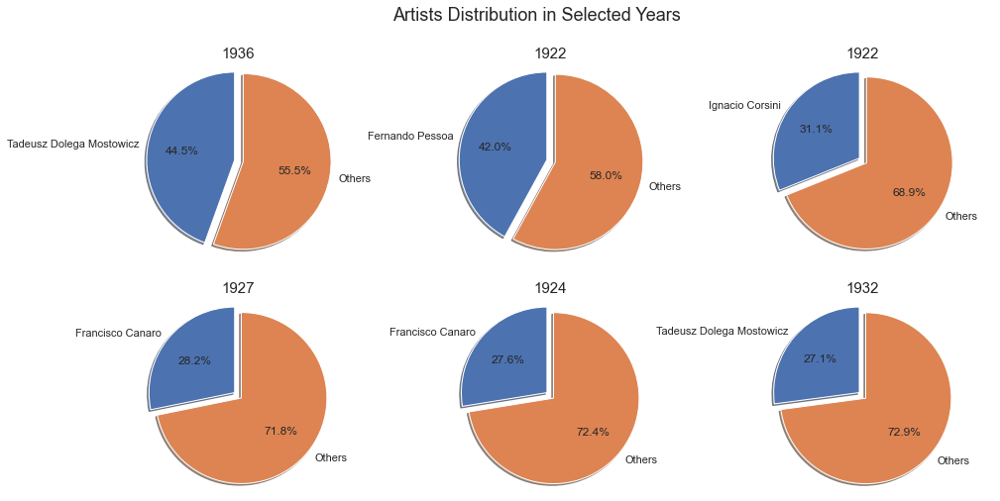

In [62]:
fig, axs = plt.subplots(2, 3 , figsize=(16,8))
plt.suptitle('Artists Distribution in Selected Years' , fontsize=18)
for x in range(6):
    i = math.floor(x/3)
    y = x - i*3
    temp1 = temp.iloc[x]
    labels = [temp1.artists , "Others"]
    sizes = [temp1.proportion, temp1.Others]
    explode = (0.1, 0,)  
    axs[i , y].pie(sizes, explode=explode, labels=labels, autopct='%1.1f%%',shadow=True, startangle=90)
    axs[i , y].axis('equal')  
    axs[i , y].set_title(temp1.year , fontsize=15)

## Decade Analysis

In [63]:
df_numeric = df_data_main.drop(columns = ['name' , 'artists'])
year = df_numeric.year.unique()
temp = df_numeric[df_numeric.year == year[0]].describe()
temp = temp.iloc[1].to_frame()
temp.rename(columns = {'mean': year[0]}, inplace = True) 
temp

for yr in year[1:]:
    temp1 = df_numeric[df_numeric.year == yr].describe()
    temp1 = temp1.iloc[1].to_frame()
    temp1.rename(columns = {'mean': yr}, inplace = True)
    temp = pd.merge(temp , temp1 , right_index = True , left_index = True)
    
temp = temp.drop(index = 'year')
temp = temp.T.reset_index().rename(columns={'index': 'year'})
temp["duration_ms"] = temp["duration_ms"]/1000
temp = temp.rename(columns = {"duration_ms" :"duration" })
temp

,year,acousticness,danceability,duration,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo,valence
0,1920,0.615071,0.520221,237.426755,0.416347,0.130303,0.355924,4.787879,0.216085,-12.748036,0.627273,0.645455,0.085256,113.941536,0.487643
1,1921,0.854134,0.446471,246.787552,0.252671,0.075862,0.298936,5.103448,0.207768,-16.238483,0.668966,0.317241,0.081846,103.739807,0.400629
2,1922,0.826143,0.579193,139.860664,0.228543,0.000000,0.245192,4.865546,0.259093,-20.765882,0.663866,0.092437,0.470957,100.308756,0.573571
3,1923,0.956567,0.577431,177.805249,0.262316,0.000000,0.366020,4.767956,0.228467,-14.112989,0.790055,5.254144,0.094277,113.677514,0.625006
4,1924,0.937965,0.550717,191.980456,0.349203,0.000000,0.578589,5.690265,0.234154,-14.170358,0.743363,0.690265,0.092822,120.766509,0.668895
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97,2017,0.206170,0.580062,240.756875,0.686857,0.234970,0.240221,5.332665,0.232091,-8.057848,0.608717,33.255511,0.099089,121.769862,0.435523
98,2018,0.231961,0.601938,223.425782,0.659742,0.257305,0.225141,5.392857,0.235077,-8.165363,0.581981,28.948052,0.125560,123.578736,0.419897
99,2019,0.269244,0.604480,222.286210,0.626423,0.254826,0.210692,5.313707,0.219751,-8.523349,0.602799,34.608591,0.110090,122.187255,0.456021
100,2020,0.205097,0.598697,218.498235,0.673594,0.185507,0.254095,5.341159,0.243745,-8.108042,0.593333,26.851014,0.100344,124.185770,0.449828


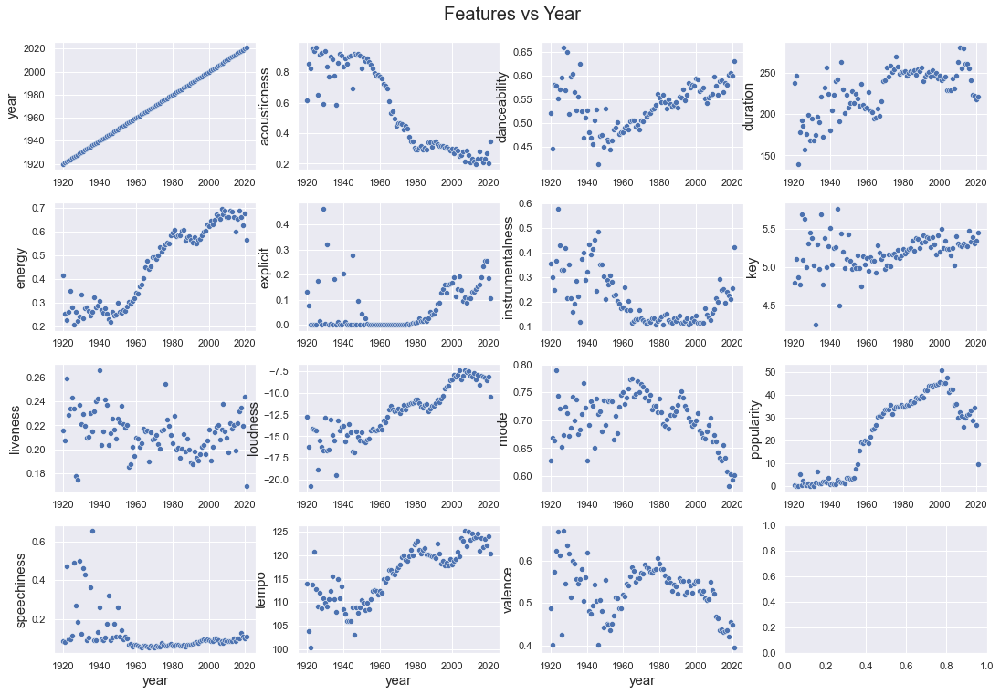

In [64]:
def multiple_plot(df, features):
    plots_count = len(features)
    cols = math.ceil(np.sqrt(plots_count))
    rows = math.ceil(plots_count/cols)
    fig, axs = plt.subplots(rows, cols)
    fig.tight_layout()
    fig.suptitle('Features vs Year'  , fontsize=20 , y=1.03)
    for index, col in enumerate(features):
        a = math.floor(index/cols)
        b = index - a*cols   
        if rows == 1:
            if cols == 1:
                g = sns.scatterplot(data=df, x="year", y= col , ax = axs)
            else:
                g = sns.scatterplot(data=df, x="year", y= col , ax = axs[b])
        else:
            g = sns.scatterplot(data=df, x="year", y= col , ax = axs[a , b])
        g.set_ylabel(col , fontsize=15)
        if a < 3:
            g.set(xlabel=None)
        else:
            g.set_xlabel('year' , fontsize=15)
            
sns.set(rc={'figure.figsize':(15,10)})   
multiple_plot(temp , temp.columns)

## 6. Feature Analysis (Boxplot)

## Note:
We get our first hint of duration being extremely skewed in the following plot

Text(0, 0.5, 'Standardised Value')

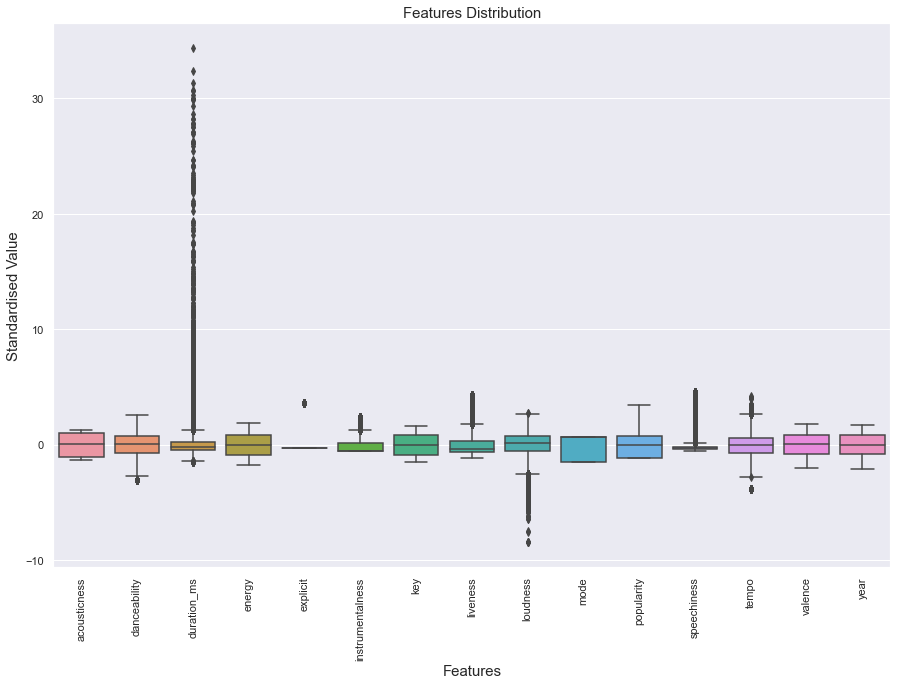

In [65]:
data_m = df_data_main.drop(columns = ['name' , 'artists' , 'id' , 'release_date'])
#need to do standardization and unpivot for violin and box plots
data_std = (data_m - data_m.mean()) / (data_m.std())      
data_m = pd.melt(data_std , var_name="features", value_name='standardised value')
plt.figure(figsize=(15,10))
ax = sns.boxplot(x="features", y="standardised value", data=data_m)
plt.xticks(rotation=90);
ax.set_title("Features Distribution" , fontsize = 15)
ax.set_xlabel('Features' , fontsize=15)
ax.set_ylabel('Standardised Value' , fontsize=15)

In [66]:
cols = ['valence', 'tempo', 'speechiness', 'loudness', 'liveness', 'instrumentalness',
        'explicit', 'energy', 'danceability', 'acousticness']

### 6.b Exploring PCA

#### Note: Only one feature is shown since these plots will crash the notebook in large numbers

In [67]:
pca = PCA(n_components=3)
values = pca.fit_transform(useful_data[cols])

In [68]:
fig = go.Figure(data=[
            go.Scatter3d(
            x = values[:,0],
            y = values[:,1],
            z = values[:,2],
            mode = 'markers',
            marker = dict(
                    size=6,
                    color=useful_data.tempo.values,
                    colorbar={'title':'Tempo'},
                    opacity=0.7))
])

fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()